# Visualising Nederland

In [1]:
from pathlib import Path

import fiona
import geopandas as gpd
import folium

In [2]:
data_folder = Path('../../../data')

In [3]:
fiona.listlayers(f'{data_folder}/nederland_admin_areas.gpkg')

['gemeentegebied', 'landgebied', 'provinciegebied']

## Country

In [4]:
country = gpd.read_file(f'{data_folder}/nederland_admin_areas.gpkg', layer='landgebied')
country.shape

(1, 4)

In [5]:
country.head(1)

,identificatie,naam,code,geometry
0,LND6030,Nederland,6030,"MULTIPOLYGON (((123361.236 383402.986, 123365...."


<Axes: >

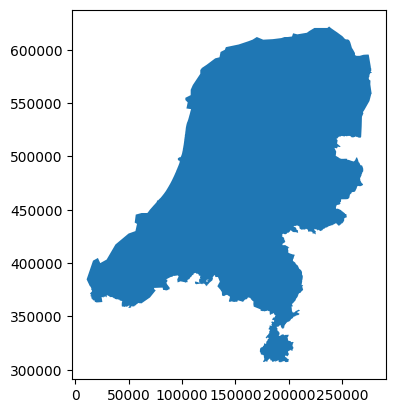

In [6]:
country.plot()

In [7]:
f = folium.Figure(width=1000, height=500)
m = folium.Map(
    tiles='https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}',
    attr='USGS US Imagery',
    max_zoom=8,
).add_to(f)

folium.GeoJson(
    country,
    style_function= lambda feature: {
        'fillOpacity': 0.1,
    },
    highlight_function= lambda feature: {
        'fillOpacity': 0.2
    },
    popup=folium.GeoJsonPopup(
        fields=['naam'],
        aliases=['Country:']
    ),
    popup_keep_highlighted=True,
).add_to(m)

m.fit_bounds(m.get_bounds())
m.save('../maps/country.html')
m

## Provinces

In [8]:
provinces = gpd.read_file(f'{data_folder}/nederland_admin_areas.gpkg', layer='provinciegebied')
provinces.shape

(12, 6)

In [9]:
provinces.head(1)

,identificatie,naam,code,ligt_in_land_code,ligt_in_land_naam,geometry
0,PV22,Drenthe,22,6030,Nederland,"MULTIPOLYGON (((231437.815 516445.643, 231430...."


<Axes: >

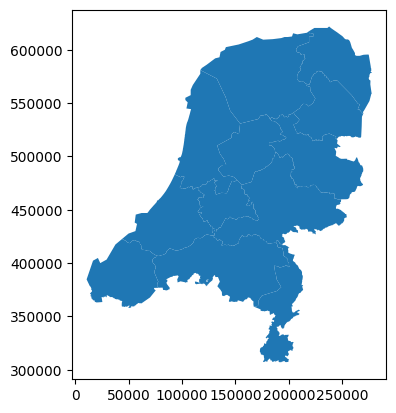

In [10]:
provinces.plot()

In [11]:
f = folium.Figure(width=1000, height=500)
m = folium.Map(
    tiles='https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}',
    attr='USGS US Imagery',
    max_zoom=8
).add_to(f)

folium.GeoJson(
    provinces,
    style_function= lambda feature: {
        'fillOpacity': 0.1,
    },
    highlight_function= lambda feature: {
        'fillOpacity': 0.2,
    },
    popup=folium.GeoJsonPopup(
    fields=['naam'],
    aliases=['Province:'],
    ),
    popup_keep_highlighted=True
).add_to(m)

m.fit_bounds(m.get_bounds())
m.save('../maps/provinces.html')
m

## Municipalities

In [12]:
cities = gpd.read_file(f'{data_folder}/nederland_admin_areas.gpkg', layer='gemeentegebied')
cities.shape

(342, 6)

In [13]:
cities.head(1)

,identificatie,naam,code,ligt_in_provincie_code,ligt_in_provincie_naam,geometry
0,GM0263,Maasdriel,0263,25,Gelderland,"MULTIPOLYGON (((146637.319 416737.822, 146700 ..."


<Axes: >

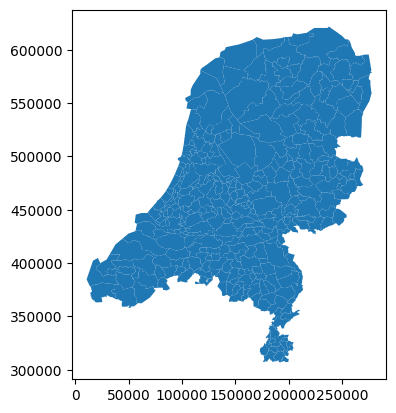

In [14]:
cities.plot()

In [15]:
f = folium.Figure(width=1000, height=500)
m = folium.Map(
    tiles='https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}',
    attr='USGS US Imagery',
    max_zoom=8
).add_to(f)

folium.GeoJson(
    cities,
    style_function= lambda feature: {
        'fillOpacity': 0.1,
        'weight': 1
    },
    highlight_function= lambda feature: {
        'fillOpacity': 0.2
    },
    popup=folium.GeoJsonPopup(
        fields=['naam'],
        aliases=['Municipality:']
    ),
    popup_keep_highlighted=True
).add_to(m)

m.fit_bounds(m.get_bounds())
m.save('../maps/cities.html')
m